In [1]:
!pip install ultralytics
!pip install git+https://github.com/facebookresearch/detectron2.git

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 1.0/1.0 MB 10.3 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 2.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 13.8/13.8 MB 41.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 24.6/24.6 MB 41.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 883.7/883.7 kB 24.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 2.8 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 11.7 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 7.5 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 5.9 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 67.5 MB/s eta 0:00:00
  Attempting uninstall: nvidia-nvjitlink-cu12
    Found existing installation: nvidia-nvjitlink-cu12 12.5.82
    Uninstalling 

### 📚 Краткое описание представленных методов Object Detection

---

#### 🔹 **HOG + SVM**
- **Тип**: Классический алгоритм
- **Принцип**: Выделяются градиенты (HOG-фичи), затем классифицируются при помощи SVM.
- **Особенности**: Быстрый, работает без нейросетей, применим к задачам типа pedestrian detection.

---

#### 🔹 **Fast R-CNN**
- **Тип**: Two-stage
- **Принцип**: Один раз прогоняет всё изображение через сверточную сеть. Далее используется **RoI Pooling** для регионов, предложенных Selective Search. На выходе — классификация и регрессия бокса.
- **Особенности**: Быстрее R-CNN, но всё ещё использует внешний генератор регионов.

---

#### 🔹 **Faster R-CNN**
- **Тип**: Two-stage
- **Принцип**: Вводит **Region Proposal Network (RPN)**, которая генерирует области интереса прямо на feature map. Эти регионы передаются на классификацию и регрессию.
- **Особенности**: Более быстрая и точная альтернатива Fast R-CNN.

---

#### 🔹 **YOLO (v5/v8/v11 и др.)**
- **Тип**: One-stage
- **Принцип**: Делит изображение на сетку и предсказывает боксы и классы прямо с выхода нейросети. Нет отдельного этапа предложений.
- **Особенности**: Очень высокая скорость, используется в реальном времени.

---

#### 🔹 **SSD (Single Shot Detector)**
- **Тип**: One-stage
- **Принцип**: Делает предсказания на нескольких уровнях feature map. Использует anchor boxes разных размеров и соотношений.
- **Особенности**: Быстрый и компактный, подходит для мобильных устройств.

---

#### 🔹 **RetinaNet**
- **Тип**: One-stage
- **Принцип**: Добавляет **Focal Loss** для борьбы с дисбалансом между фоном и объектами. Использует Feature Pyramid Network (FPN).
- **Особенности**: Баланс между скоростью и точностью. Хорошо работает с несбалансированными данными.

---

#### 🔹 **FCOS (Fully Convolutional One-Stage)**
- **Тип**: One-stage, Anchor-Free
- **Принцип**: Не использует anchor boxes. Каждый пиксель предсказывает, есть ли объект, его координаты и класс.
- **Особенности**: Простота архитектуры, высокая универсальность, хорошо работает с плотными и мелкими объектами.

---

#### 🔹 **DETR (DEtection TRansformer)**
- **Тип**: One-stage, основан на Transformer
- **Принцип**: Использует encoder-decoder архитектуру трансформера для глобального внимания по изображению. Объекты предсказываются как "object queries".
- **Особенности**: Нет NMS, нет якорей, требует большой объём данных и ресурсов.

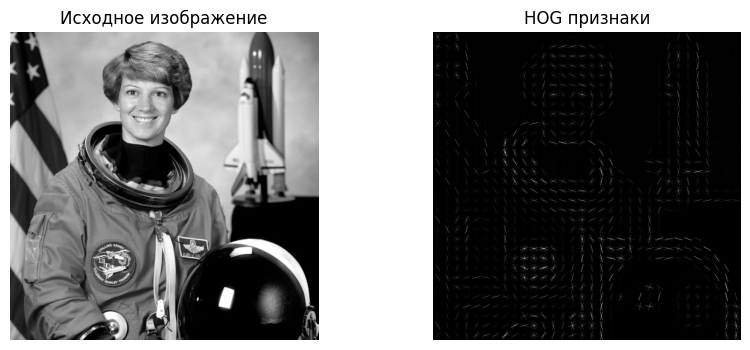

In [9]:
# @title HOG + SVM

from skimage.feature import hog
from skimage import data
from skimage.color import rgb2gray

image = data.astronaut()
gray = rgb2gray(image)

fd, hog_image = hog(
    gray,
    orientations=8,
    pixels_per_cell=(16, 16),
    cells_per_block=(1, 1),
    visualize=True,
    feature_vector=True
)

plt.figure(figsize=(10, 4))
plt.subplot(1, 2, 1)
plt.imshow(gray, cmap="gray")
plt.title("Исходное изображение")
plt.axis('off')

plt.subplot(1, 2, 2)
plt.imshow(hog_image, cmap="gray")
plt.title("HOG признаки")
plt.axis('off')

plt.show()

/usr/local/lib/python3.11/dist-packages/torchvision/utils.py:233: UserWarning: Argument 'font_size' will be ignored since 'font' is not set.
  warnings.warn("Argument 'font_size' will be ignored since 'font' is not set.")


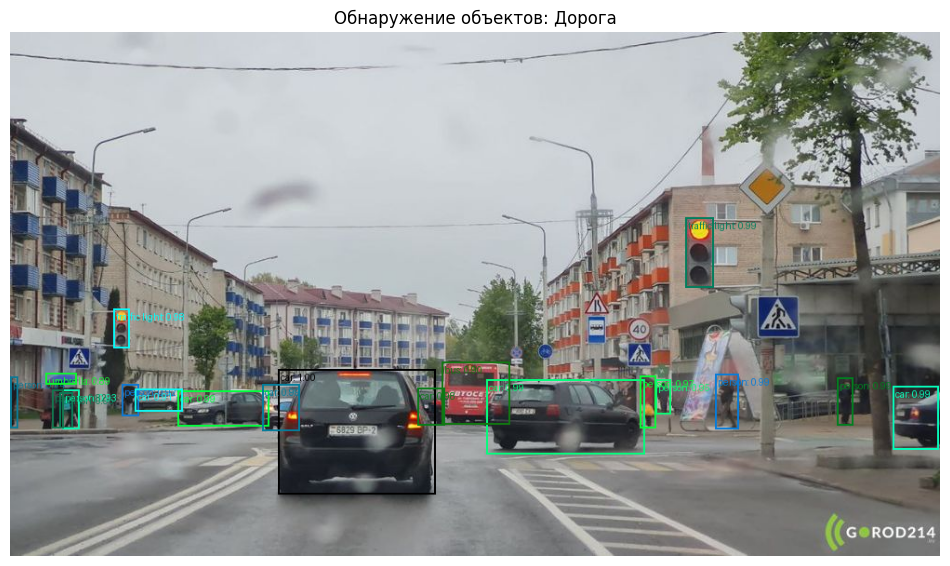

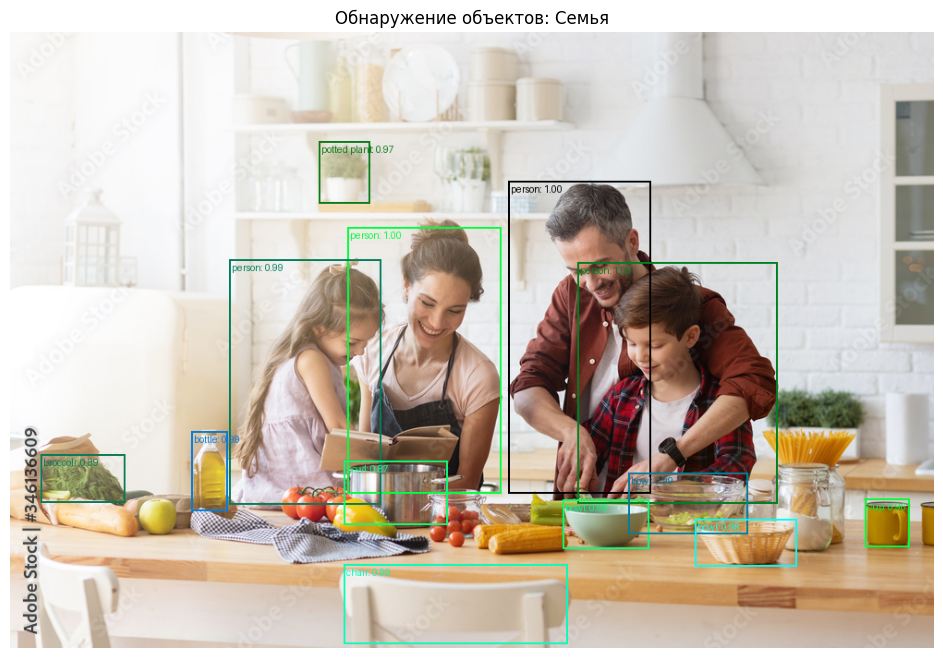

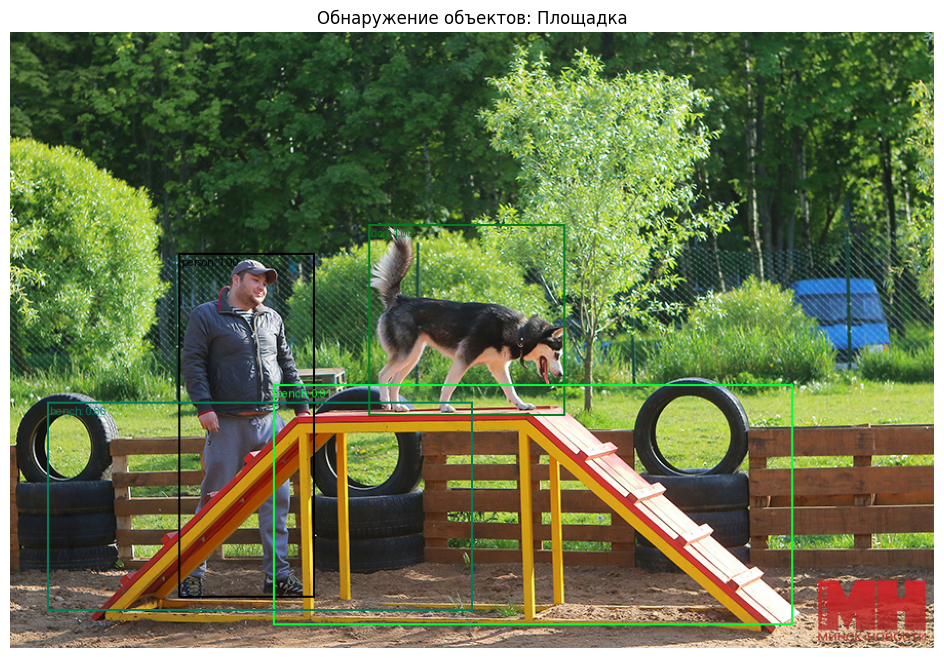

Время выполнения: 31.32 секунд


In [21]:
# @title Faster R-CNN

import time
import torch
import torchvision.transforms as T
import matplotlib.pyplot as plt
from torchvision.io import read_image
from torchvision.models.detection import fasterrcnn_resnet50_fpn
from torchvision.utils import draw_bounding_boxes
from torchvision.models.detection import FasterRCNN_ResNet50_FPN_Weights


start_time = time.time()

# Загружаем модель и веса с метками
weights = FasterRCNN_ResNet50_FPN_Weights.DEFAULT
model = fasterrcnn_resnet50_fpn(weights=weights)
model.eval()

# Классы COCO
categories = weights.meta["categories"]

# Загружаем изображения
img_road = read_image("/content/drive/MyDrive/Дорога.jpg")
img_family = read_image("/content/drive/MyDrive/Семья.jpg")
img_dogpark = read_image("/content/drive/MyDrive/Площадка.jpg")

# Список изображений и их названия
images = [img_road, img_family, img_dogpark]
titles = ["Дорога", "Семья", "Площадка"]

# Трансформации из весов
transform = weights.transforms()

threshold = 0.8

for img, title in zip(images, titles):
    # Преобразуем и добавляем batch dimension
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    # Фильтруем по порогу
    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    # Формируем подписи с классом и вероятностью
    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    # Рисуем боксы на копии исходного изображения (uint8 формат)
    img_with_boxes = draw_bounding_boxes(
        img.clone(),
        boxes,
        labels=label_names,
        width=2,
        font_size=20
    )

    # Переводим [C, H, W] → [H, W, C] и в numpy
    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    # Отображаем
    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.axis("off")
    plt.title(f"Обнаружение объектов: {title}")
    plt.show()

end_time = time.time()
execution_time = end_time - start_time

print(f"Время выполнения: {execution_time:.2f} секунд")

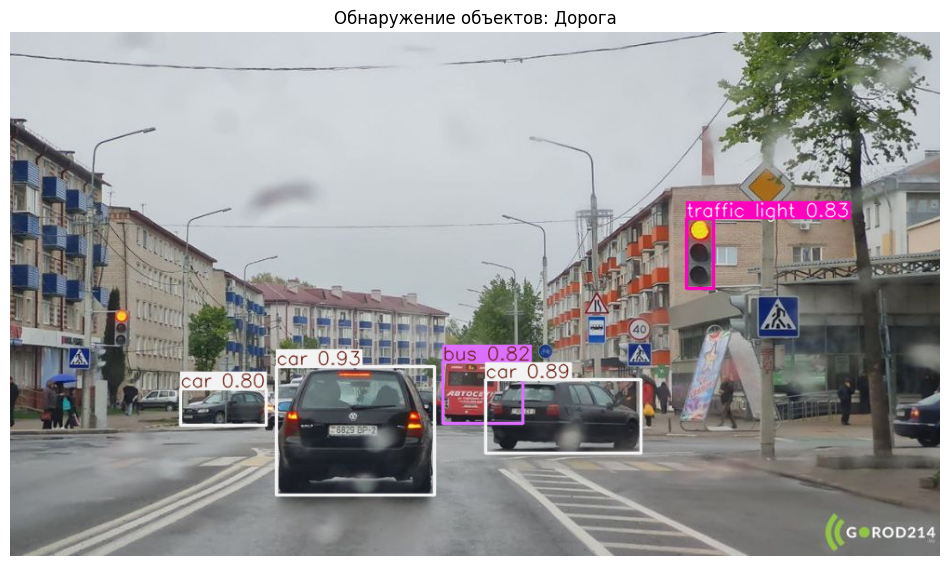

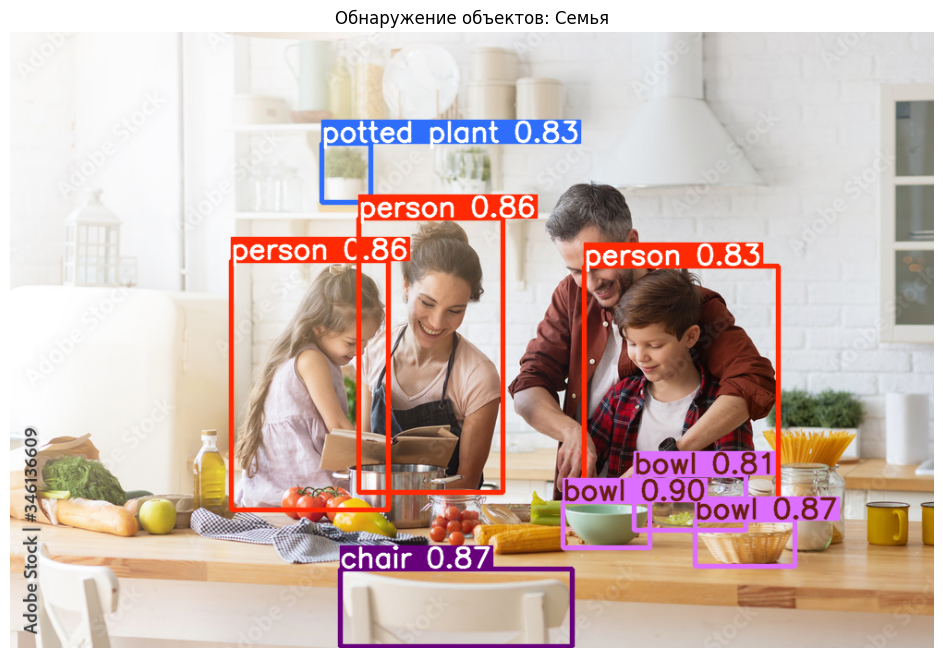

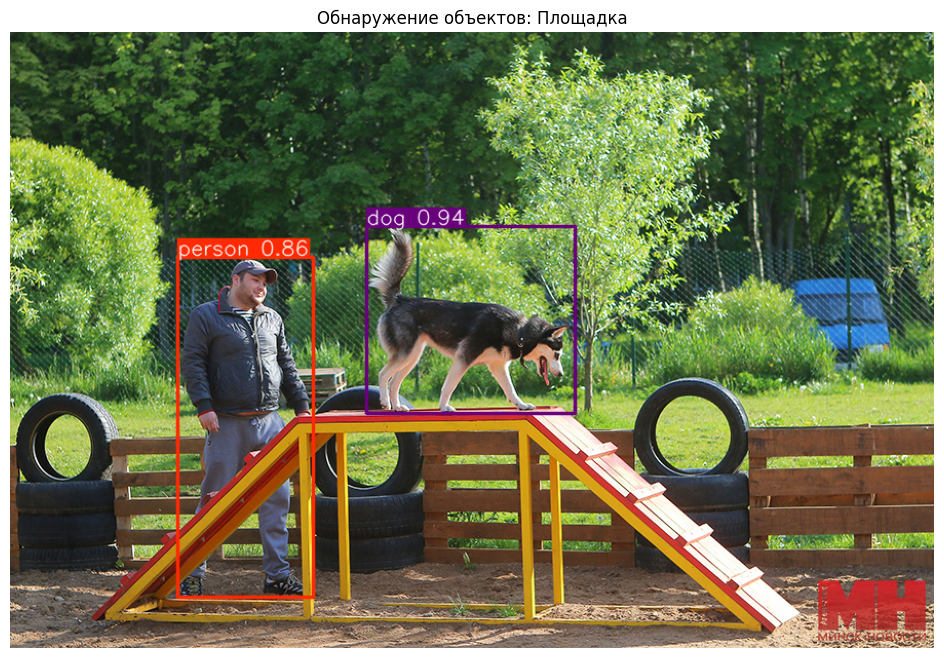

Время выполнения: 3.30 секунд


In [30]:
# @title YOLOv11

from ultralytics import YOLO
import cv2


start_time = time.time()

model = YOLO('yolo11s.pt')  # Можно заменить на 'yolo11n.pt', 'yolo11m.pt', 'yolo11l.pt' или 'yolo11x.pt'. Каждая последующая более тяжёлая

image_paths = [
    "/content/drive/MyDrive/Дорога.jpg",
    "/content/drive/MyDrive/Семья.jpg",
    "/content/drive/MyDrive/Площадка.jpg"
]
titles = ["Дорога", "Семья", "Площадка"]

conf_threshold = 0.8

for img_path, title in zip(image_paths, titles):

    img = cv2.imread(img_path)
    img_rgb = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)

    results = model.predict(source=img_rgb, conf=conf_threshold, verbose=False)

    result = results[0]
    boxes = result.boxes
    names = model.names

    annotated_img = result.plot()

    plt.figure(figsize=(12, 8))
    plt.imshow(annotated_img)
    plt.axis("off")
    plt.title(f"Обнаружение объектов: {title}")
    plt.show()

end_time = time.time()
execution_time = end_time - start_time
print(f"Время выполнения: {execution_time:.2f} секунд")

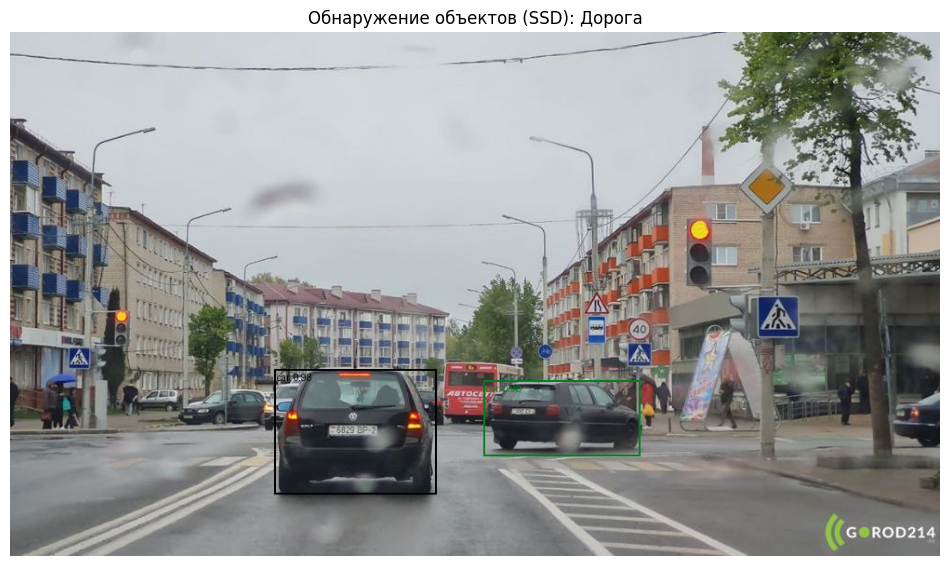

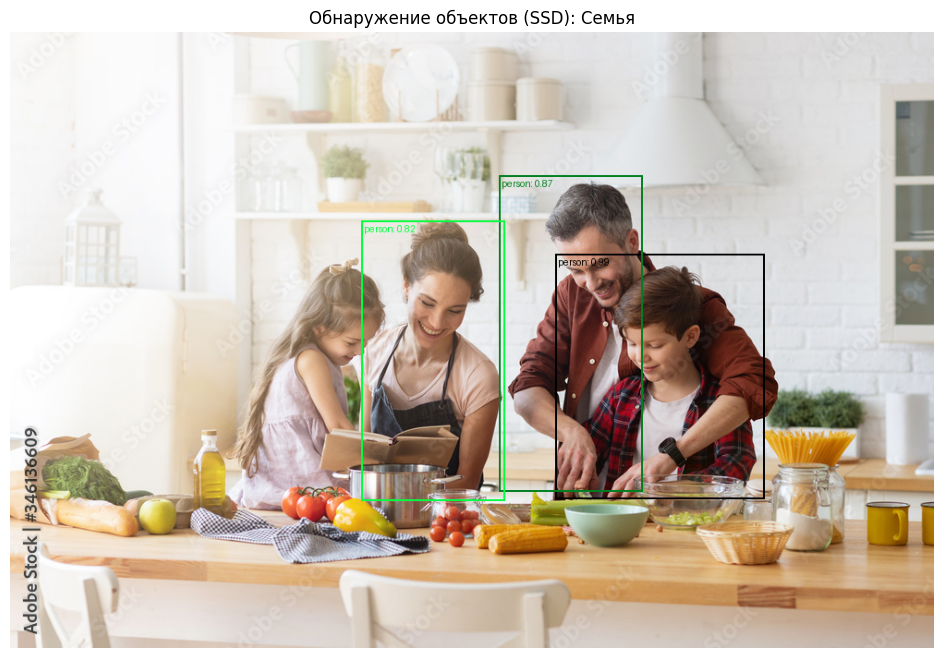

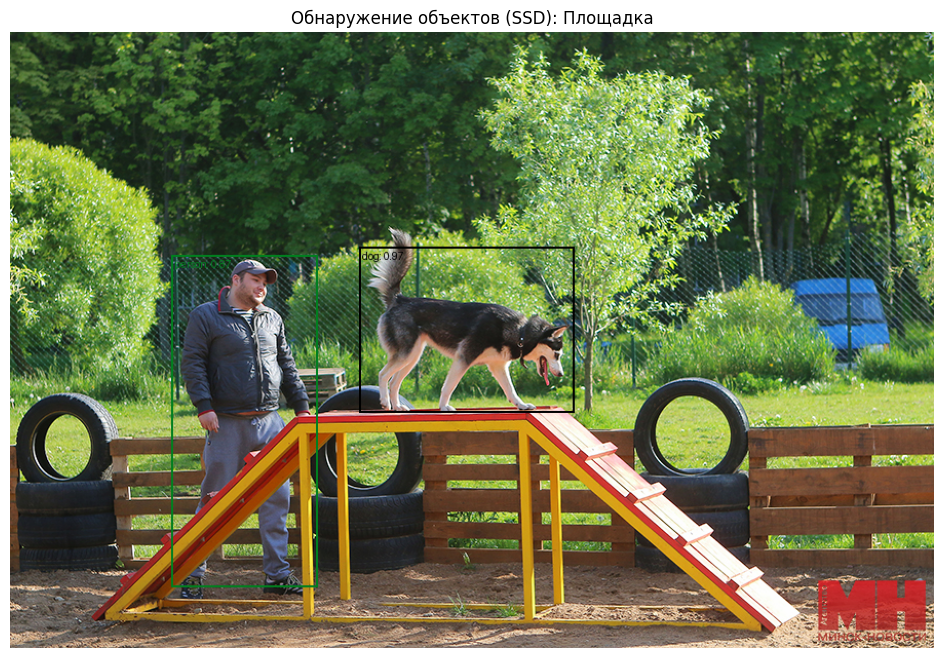

Время выполнения: 10.59 секунд


In [32]:
# @title SSD (Single-Shot Detector)

from torchvision.models.detection import ssd300_vgg16, SSD300_VGG16_Weights


start_time = time.time()

weights = SSD300_VGG16_Weights.DEFAULT
model = ssd300_vgg16(weights=weights)
model.eval()

categories = weights.meta["categories"]

transform = weights.transforms()

image_paths = [
    "/content/drive/MyDrive/Дорога.jpg",
    "/content/drive/MyDrive/Семья.jpg",
    "/content/drive/MyDrive/Площадка.jpg"
]
titles = ["Дорога", "Семья", "Площадка"]

threshold = 0.8

for path, title in zip(image_paths, titles):

    img = read_image(path)
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_with_boxes = draw_bounding_boxes(
        img.clone(), boxes, labels=label_names, width=2, font_size=20
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.title(f"Обнаружение объектов (SSD): {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

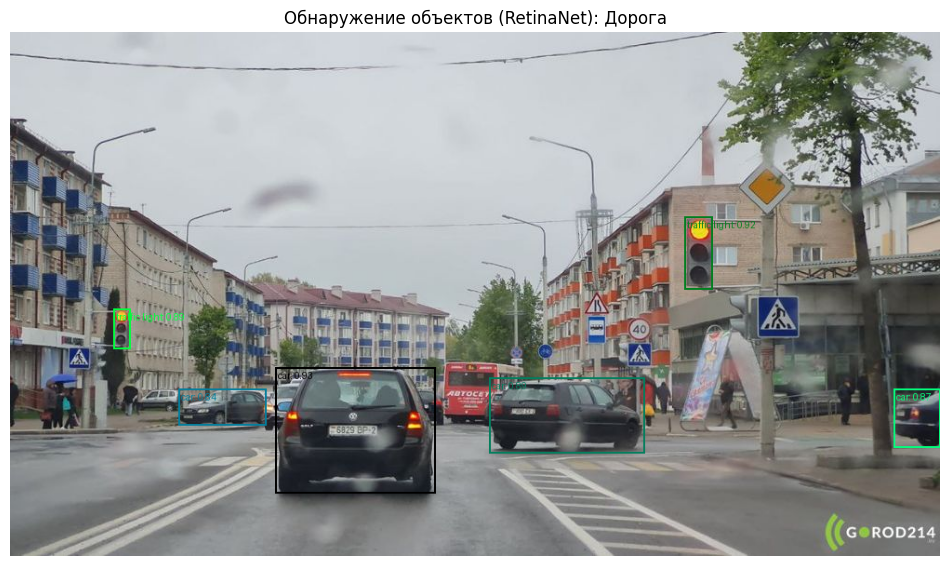

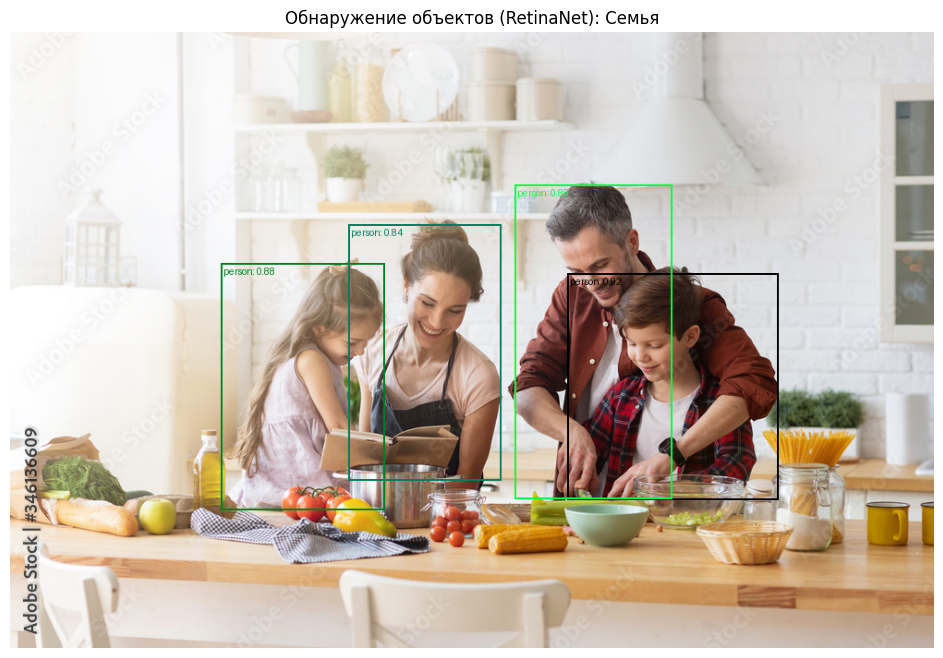

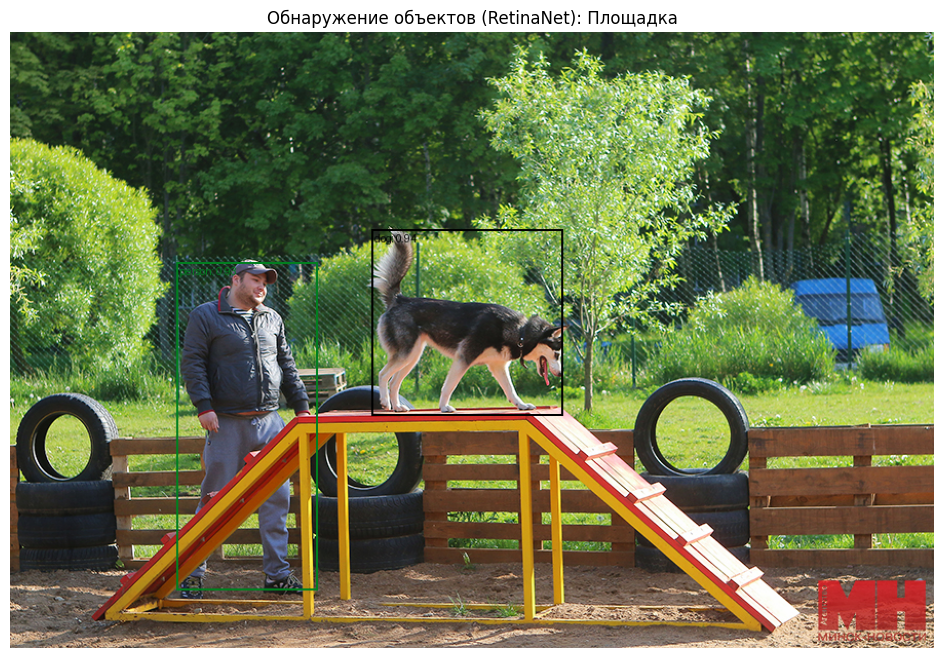

Время выполнения: 35.32 секунд


In [34]:
# @title RetinaNet

from torchvision.models.detection import retinanet_resnet50_fpn, RetinaNet_ResNet50_FPN_Weights


start_time = time.time()

weights = RetinaNet_ResNet50_FPN_Weights.DEFAULT
model = retinanet_resnet50_fpn(weights=weights)
model.eval()

categories = weights.meta["categories"]
transform = weights.transforms()

image_paths = [
    "/content/drive/MyDrive/Дорога.jpg",
    "/content/drive/MyDrive/Семья.jpg",
    "/content/drive/MyDrive/Площадка.jpg"
]
titles = ["Дорога", "Семья", "Площадка"]

threshold = 0.8

for path, title in zip(image_paths, titles):
    img = read_image(path)
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_with_boxes = draw_bounding_boxes(
        img.clone(), boxes, labels=label_names, width=2, font_size=20
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.title(f"Обнаружение объектов (RetinaNet): {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

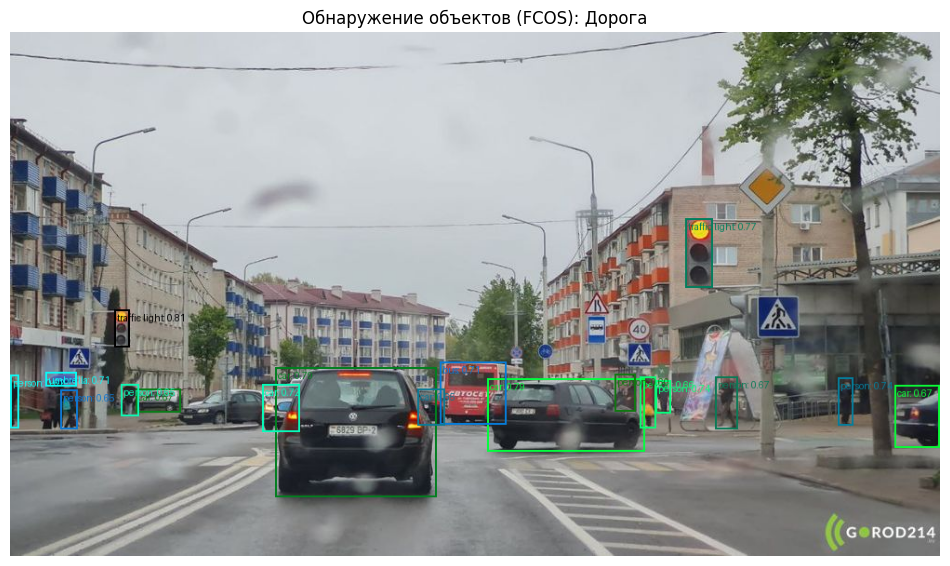

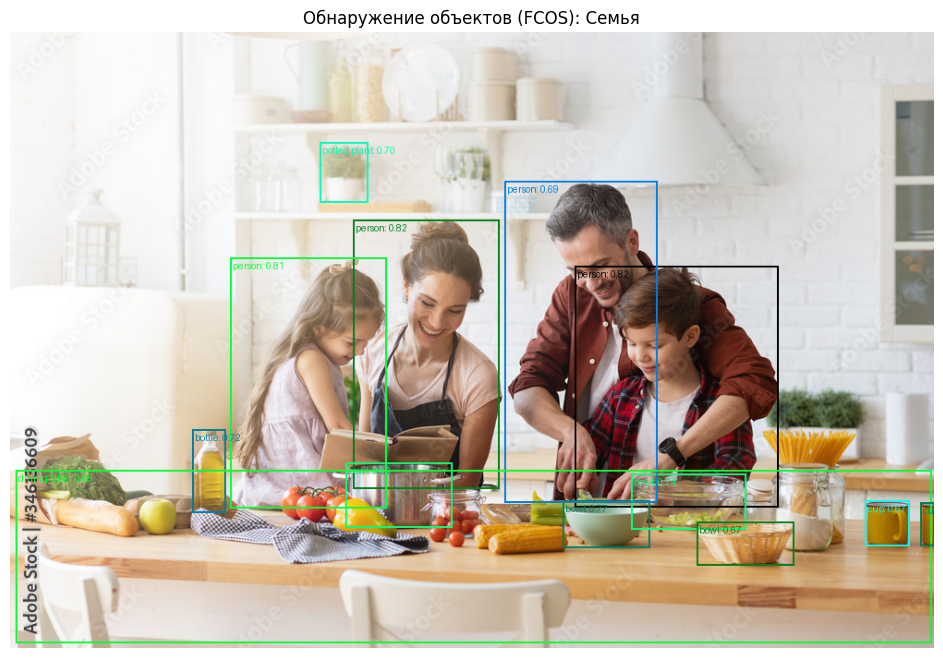

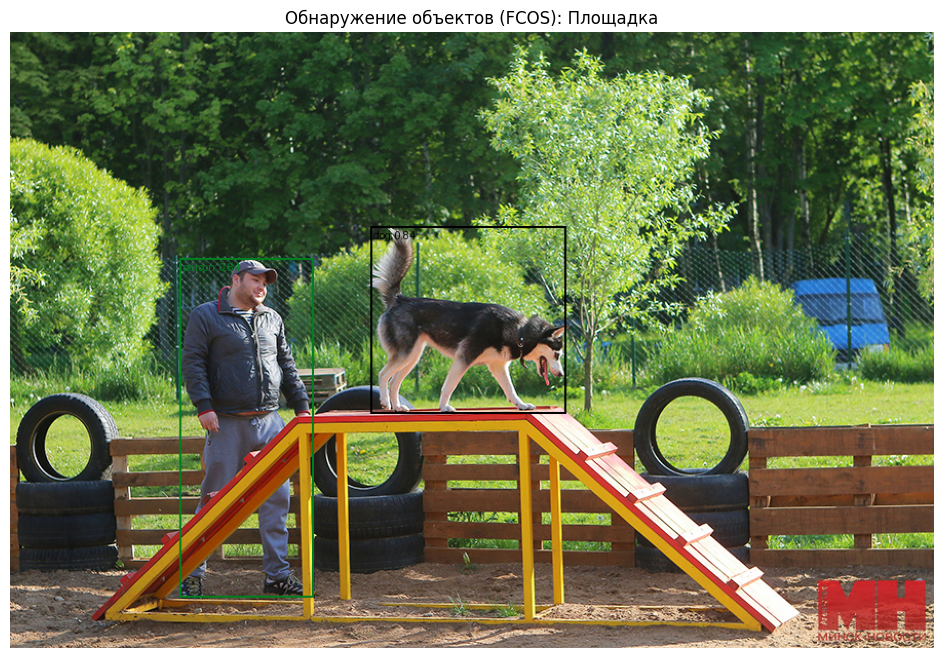

Время выполнения: 30.21 секунд


In [48]:
# @title FCOS

from torchvision.models.detection import fcos_resnet50_fpn, FCOS_ResNet50_FPN_Weights


start_time = time.time()

weights = FCOS_ResNet50_FPN_Weights.DEFAULT
model = fcos_resnet50_fpn(weights=weights)
model.eval()

categories = weights.meta["categories"]
transform = weights.transforms()

image_paths = [
    "/content/drive/MyDrive/Дорога.jpg",
    "/content/drive/MyDrive/Семья.jpg",
    "/content/drive/MyDrive/Площадка.jpg"
]
titles = ["Дорога", "Семья", "Площадка"]

threshold = 0.6

for path, title in zip(image_paths, titles):
    img = read_image(path)
    img_input = transform(img).unsqueeze(0)

    with torch.no_grad():
        output = model(img_input)[0]

    boxes = output["boxes"][output["scores"] > threshold]
    labels = output["labels"][output["scores"] > threshold]
    scores = output["scores"][output["scores"] > threshold]

    label_names = [f"{categories[label]}: {score:.2f}" for label, score in zip(labels, scores)]

    img_with_boxes = draw_bounding_boxes(
        img.clone(), boxes, labels=label_names, width=2, font_size=20
    )

    img_np = img_with_boxes.permute(1, 2, 0).cpu().numpy()

    plt.figure(figsize=(12, 8))
    plt.imshow(img_np)
    plt.title(f"Обнаружение объектов (FCOS): {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


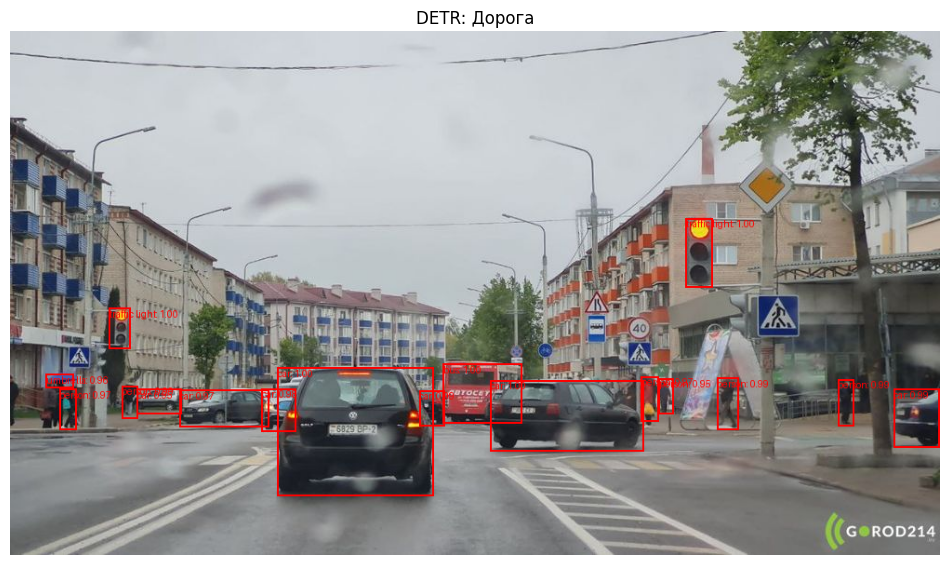

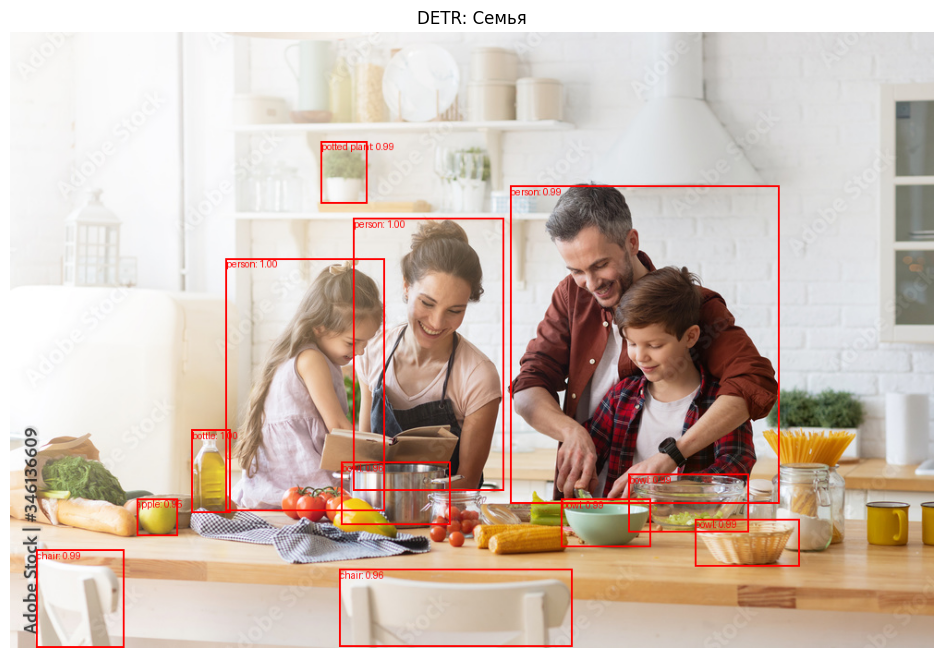

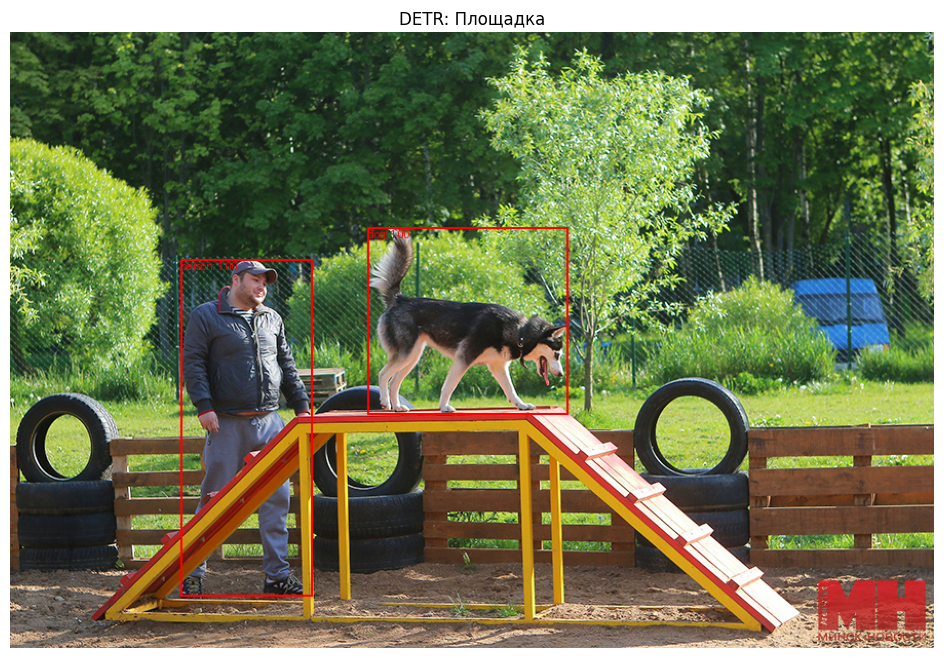

Время выполнения: 17.61 секунд


In [54]:
# @title DETR (DEtection TRansformer)

from transformers import DetrImageProcessor, DetrForObjectDetection
from PIL import Image, ImageDraw, ImageFont


start_time = time.time()

image_paths = [
    "/content/drive/MyDrive/Дорога.jpg",
    "/content/drive/MyDrive/Семья.jpg",
    "/content/drive/MyDrive/Площадка.jpg"
]
titles = ["Дорога", "Семья", "Площадка"]
threshold = 0.95

# Загрузка модели и процессора
processor = DetrImageProcessor.from_pretrained("facebook/detr-resnet-50")
model = DetrForObjectDetection.from_pretrained("facebook/detr-resnet-50")
model.eval()

for path, title in zip(image_paths, titles):
    image = Image.open(path).convert("RGB")

    # Подготовка входа
    inputs = processor(images=image, return_tensors="pt")

    with torch.no_grad():
        outputs = model(**inputs)

    # Получение предсказаний
    target_sizes = torch.tensor([image.size[::-1]])  # (H, W)
    results = processor.post_process_object_detection(outputs, target_sizes=target_sizes, threshold=threshold)[0]

    # Отрисовка боксов
    draw = ImageDraw.Draw(image)
    font = ImageFont.load_default()

    for box, score, label in zip(results["boxes"], results["scores"], results["labels"]):
        box = [round(i, 2) for i in box.tolist()]
        cls = model.config.id2label[label.item()]
        draw.rectangle(box, outline="red", width=2)
        draw.text((box[0], box[1]), f"{cls}: {score:.2f}", fill="red", font=font)

    plt.figure(figsize=(12, 8))
    plt.imshow(image)
    plt.title(f"DETR: {title}")
    plt.axis("off")
    plt.show()

end_time = time.time()
print(f"Время выполнения: {end_time - start_time:.2f} секунд")

Сравнительная таблица

| Модель         | Тип                   | Скорость | Точность | Простота | Где использовать                                         |
|----------------|------------------------|----------|----------|----------|----------------------------------------------------------|
| HOG + SVM      | Классика               | ⭐⭐⭐⭐⭐   | ⭐⭐       | ⭐⭐⭐⭐⭐   | Простой фоновый детектор, пешеходы                       |
| Fast R-CNN     | 2-stage                | ⭐⭐      | ⭐⭐⭐⭐     | ⭐⭐       | Сложные задачи, нужна Selective Search                  |
| Faster R-CNN   | 2-stage                | ⭐⭐⭐     | ⭐⭐⭐⭐⭐    | ⭐⭐       | Высокая точность, подходит для фото и промышленных задач|
| YOLOv5         | 1-stage                | ⭐⭐⭐⭐⭐   | ⭐⭐⭐      | ⭐⭐⭐⭐     | Реальное время: дроны, камеры, мобильные устройства     |
| SSD            | 1-stage                | ⭐⭐⭐⭐    | ⭐⭐⭐      | ⭐⭐⭐⭐     | Легкий детектор, подходит для встраиваемых систем        |
| RetinaNet      | 1-stage                | ⭐⭐⭐⭐    | ⭐⭐⭐⭐     | ⭐⭐       | Классовый дисбаланс, медицина, сложные фоновые сцены     |
| FCOS           | 1-stage (Anchor-Free)  | ⭐⭐⭐⭐    | ⭐⭐⭐⭐     | ⭐⭐⭐      | Без якорей: плотные сцены, улицы, перекрытия объектов    |
| DETR           | 1-stage (Transformer)  | ⭐⭐      | ⭐⭐⭐⭐     | ⭐        | Тяжёлый, но мощный трансформер, требует много данных     |

Финальные выводы:

*   Классические методы (HOG) хороши для быстрых и простых задач с простым фоном. Отличный выбор для пешеходов и задач без необходимости нейросетей.
*   Faster R-CNN и RetinaNet обеспечивают высокую точность, особенно в ситуациях с ограниченными ресурсами на тренировку, сложными классами или дисбалансом данных. Идеальны для промышленности и медицины.
*   YOLO и SSD — лидеры по скорости и пригодности для реального времени, включая встроенные системы (дроны, камеры, авто).
*   FCOS — современный anchor-free подход, избавляющий от необходимости подбора anchor boxes. Универсален, хорошо справляется с обнаружением объектов в плотных, сложных и загромождённых сценах. Лёгкий в адаптации и переносе на новые домены. Особенно полезен при наличии плотных объектов без явно выраженных форм.
*   DETR — новый класс детекторов на основе трансформеров. Очень мощный, особенно на крупных и разнообразных датасетах, но требует значительных ресурсов. За ним будущее, особенно при совместном развитии vision+language систем.







